In [1]:
import collections
import sys
from pathlib import Path

import matplotlib.pyplot as plt
import matplotlib.transforms as mtrans
import matplotlib.patches as mpatches
import numpy as np
import pandas as pd
import umap
from skimage import exposure
from mpl_toolkits.axes_grid1.anchored_artists import AnchoredSizeBar
import matplotlib.font_manager as fm
import cv2
fontprops = fm.FontProperties(size=34)
from sklearn.neighbors import NearestNeighbors
from skimage import color, measure
import seaborn as sns
from sklearn.preprocessing import MinMaxScaler
from matplotlib.colors import ListedColormap

In [2]:
%load_ext autoreload
%autoreload 2

In [3]:
# Import path
module_path = str(Path.cwd().parents[0])
if module_path not in sys.path:
    sys.path.append(module_path)
    
module_path = str(Path.cwd().parents[0] / "src")
if module_path not in sys.path:
    sys.path.append(module_path)
    

In [4]:
from config import *
import my_io as io

# Import metadata information

In [5]:
df_metadata = pd.read_csv(data_dir / 'metadata.csv')
df_metadata.head()

,Pos,Grades,Stage,Directory
0,B1,2,I,Y:\coskun-lab\Thomas\Lung IMC\data\ROI\ROI001_B1
1,B3,2,I,Y:\coskun-lab\Thomas\Lung IMC\data\ROI\ROI005_B3
2,B5,2,II,Y:\coskun-lab\Thomas\Lung IMC\data\ROI\ROI006_B5
3,C6,AT,AT,Y:\coskun-lab\Thomas\Lung IMC\data\ROI\ROI007_C6
4,D7,3,IIIA,Y:\coskun-lab\Thomas\Lung IMC\data\ROI\ROI008_D7


In [6]:
datasets = df_metadata.Directory.to_list()
datasets = [name.split('\\')[-1] for name in datasets]

In [7]:
print(datasets)

['ROI001_B1', 'ROI005_B3', 'ROI006_B5', 'ROI007_C6', 'ROI008_D7', 'ROI009_D9', 'ROI012_E1', 'ROI015_B6', 'ROI016_F3', 'ROI017_F2', 'ROI018_G1', 'ROI019_G5', 'ROI020_E5', 'ROI021_E7']


# Marker overlay plot

In [16]:
import matplotlib.pylab as pl
from matplotlib.colors import ListedColormap

DEFAULT_CHANNELS = (1, 2)

RGB_MAP = {
    1: {
        'rgb': np.array([255,0,255]),
        'range': [0,255]
    },
    2: {
        'rgb': np.array([0,255,0]),
        'range': [0,255]
    }
}

def convert_to_rgb(t, channels=DEFAULT_CHANNELS, vmax=255, rgb_map=RGB_MAP):
    """
    Converts and returns the image data as RGB image
    Parameters
    ----------
    t : np.ndarray
        original image data
    channels : list of int
        channels to include
    vmax : int
        the max value used for scaling
    rgb_map : dict
        the color mapping for each channel
        See rxrx.io.RGB_MAP to see what the defaults are.
    Returns
    -------
    np.ndarray the image data of the site as RGB channels
    """
    dim1,dim2,_ = t.shape
    colored_channels = []
    for i, channel in enumerate(channels):
        x = (t[:, :, channel-1] / vmax) / \
            ((rgb_map[channel]['range'][1] - rgb_map[channel]['range'][0]) / 255) + \
            rgb_map[channel]['range'][0] / 255
        x = np.where(x > 1., 1., x)
        x_rgb = np.array(
            np.outer(x, rgb_map[channel]['rgb']).reshape(dim1,dim2, 3),
            dtype=int)
        colored_channels.append(x_rgb)
    im = np.array(np.array(colored_channels).sum(axis=0), dtype=int)
    im = np.where(im > 255, 255, im)
    im = im.astype(np.uint8)
    return im

def plot_interaction2(marker2img, imgs, marker1, marker2, path=None):
    img = marker2img[marker1]
    p2, p98 = np.percentile(img, (0, 99.9))
    img1 = exposure.rescale_intensity(img, in_range=(p2, p98))
    img = marker2img[marker2]
    p2, p98 = np.percentile(img, (0, 99.9))
    img2 = exposure.rescale_intensity(img, in_range=(p2, p98))
    
    markers = [marker1, marker2]
    data = np.stack([img1, img2], axis=2)
    
    # Show combined for last
    img_rgb = convert_to_rgb(data, vmax=255)
    
    # Grayscale backgroun image
    avg_img = np.array(np.mean(imgs, axis=(0)))
    
    fig, ax = plt.subplots(figsize= (10,10))
    ax.imshow(avg_img, cmap = plt.get_cmap('gray'), alpha = 0.8)
    ax.imshow(img_rgb, alpha=0.8)
    ax.axis('off')
    patches =[mpatches.Patch(color=RGB_MAP[i]['rgb']/255.0,label=markers[i-1]) for i in DEFAULT_CHANNELS]
    ax.legend(handles=patches, bbox_to_anchor=(0,0), loc='lower right', borderaxespad=0., fontsize=15)
    # Add scale bar
    scalebar = AnchoredSizeBar(ax.transData,
                           200, r'$200  \mu m$', 'lower right', 
                           pad=0.1,
                           color='white',
                           frameon=False,
                           size_vertical=3,
                           fontproperties=fontprops)

    ax.add_artist(scalebar)
    
    if path:
        fig.savefig(path, bbox_inches='tight')

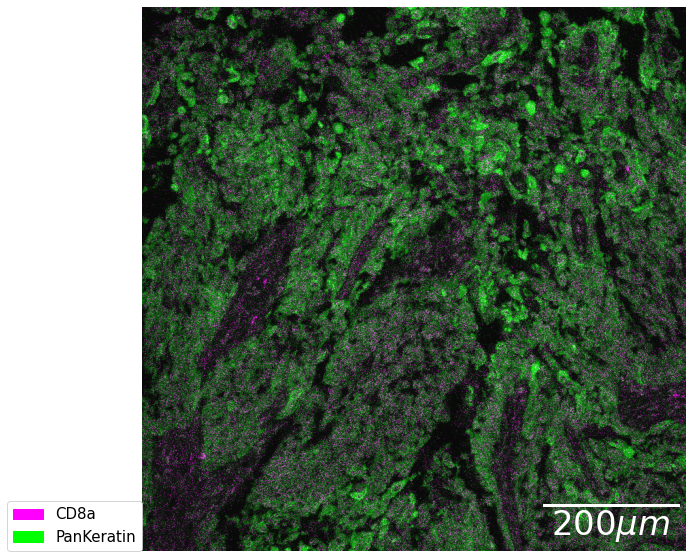

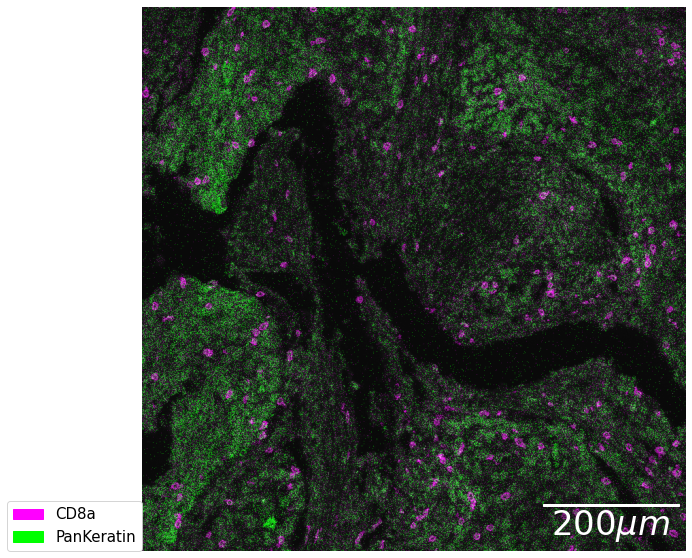

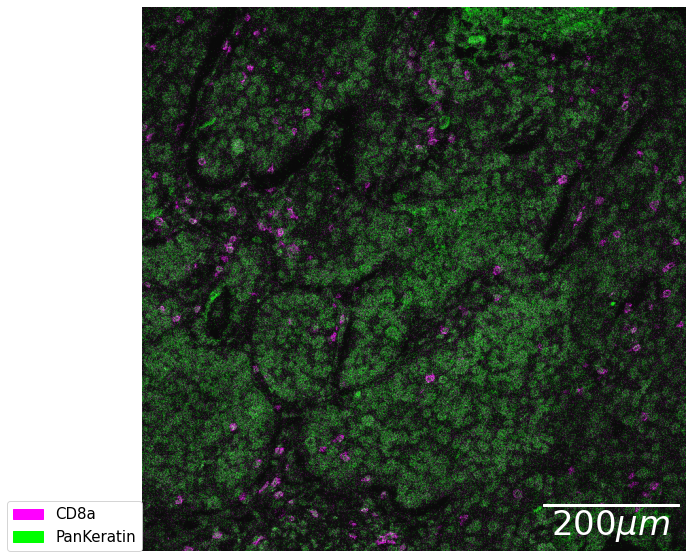

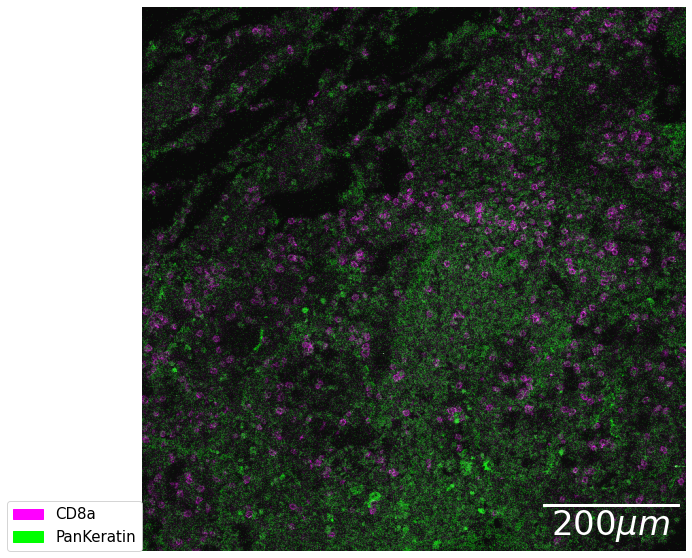

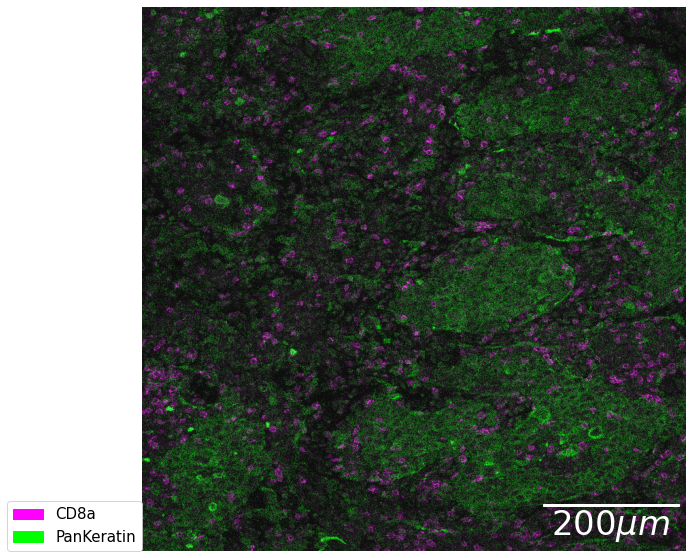

...

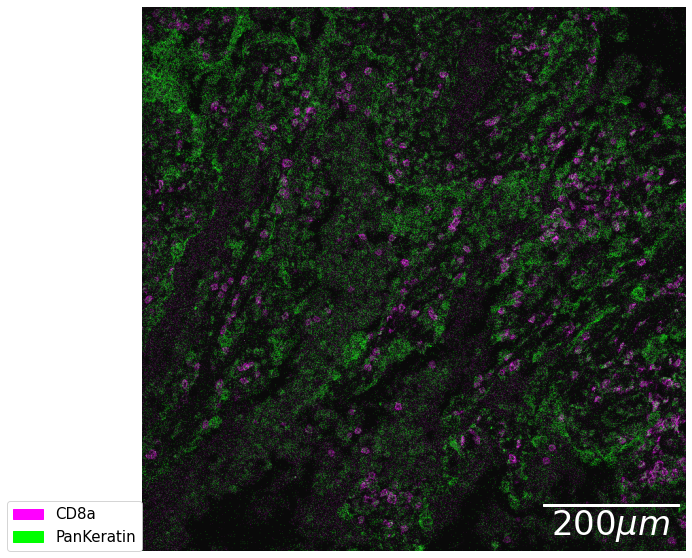

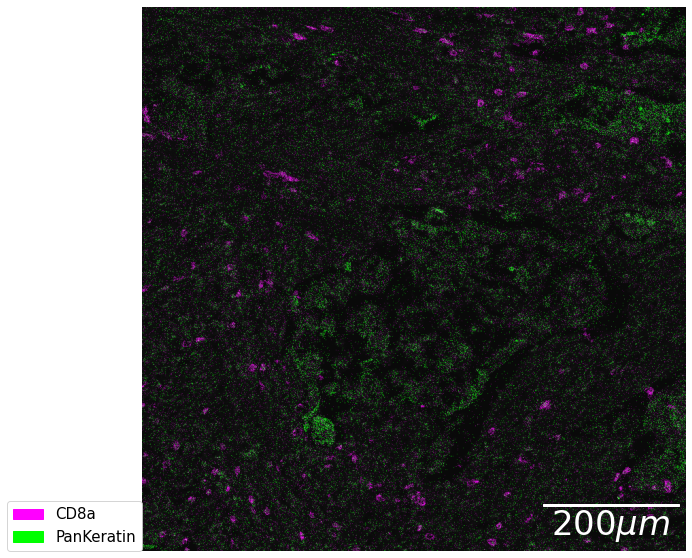

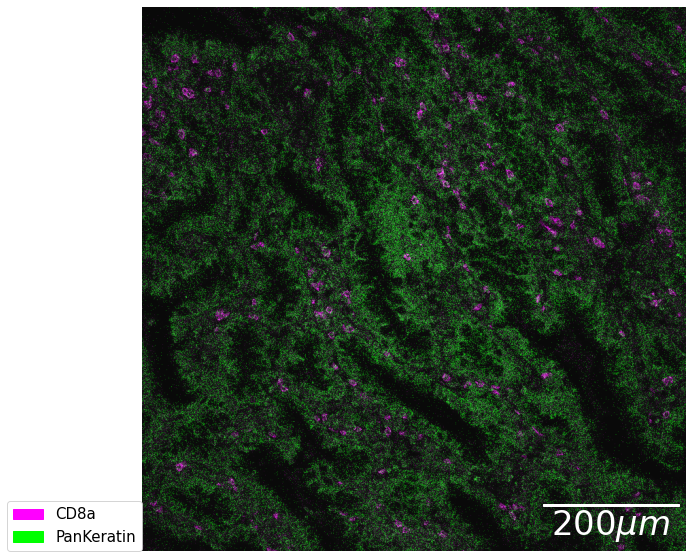

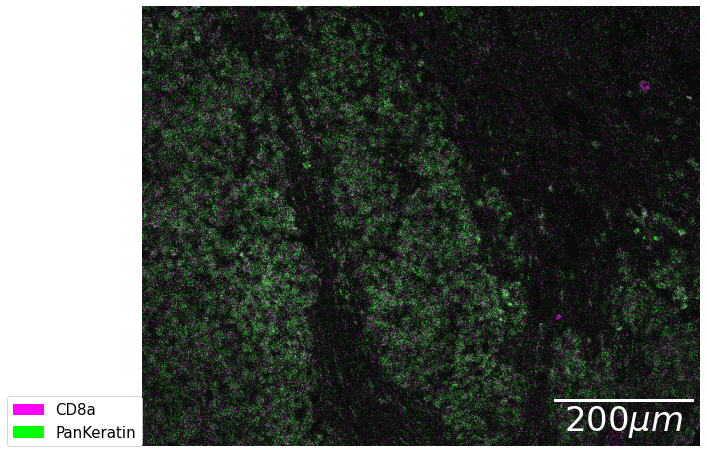

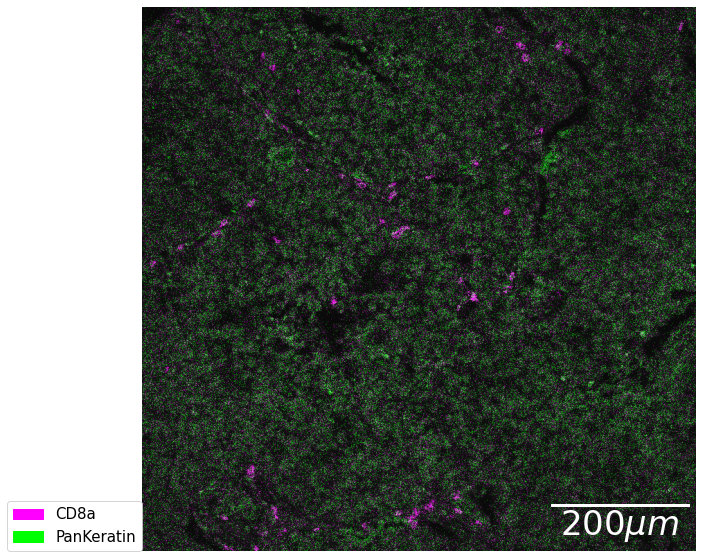

In [17]:
marker1 = 'CD8a'
marker2 = 'PanKeratin'
    
for dataset in datasets:
    imgs, markers = io.read_img(dataset, data_ROI)
    marker2img = dict(zip(markers, imgs))
    plot_interaction2(marker2img,
                imgs,
                marker1,
                marker2,
                path = data_figure / 'pairwise' / f'{dataset}_{marker1}_{marker2}.png')

# Pairwise distance plot

In [21]:
def get_cell_expression_level_mean(marker2img, marker_list, cell_mask):
    # Multiple each cell region by mean intensity 
    df_list = []
    for marker, img in marker2img.items():
        if marker in marker_list:
            # Contrast stretching
            p2, p98 = np.percentile(img, (0, 99.9))
            img = exposure.rescale_intensity(img, in_range=(p2, p98))
            exp_prop = pd.DataFrame(measure.regionprops_table(cell_mask, img, properties=['label','mean_intensity'])).set_index('label')

            df = exp_prop.rename(columns = {'mean_intensity': marker}, errors = 'raise')
            df_list.append(df)
    df_exp = pd.concat(df_list, axis=1)
    
#     scaler = MinMaxScaler()
#     df_scaled = pd.DataFrame(scaler.fit_transform(df_exp), columns=df_exp.columns)
    return df_exp

def get_expressed_cell_mask(df, marker, cell_mask):
    quantile = np.quantile(df, 0.75)
    cell_label = df[df[marker] > quantile].index.tolist()
    return np.where(np.isin(cell_mask, cell_label), cell_mask, 0)


def plot_interaction(marker1, marker2, marker2img, imgs, cell_mask, path=None):
    # Grayscale backgroun image
    avg_img = np.array(np.mean(imgs, axis=(0)))
    
    # Nearest neighbors distance
    n = 5
    neigh = NearestNeighbors(n_neighbors=n)

    df = get_cell_expression_level_mean(marker2img, [marker1, marker2], cell_mask)
    
    # Get centroid of expressed cell mask
    cell_mask1 = get_expressed_cell_mask(df, marker1, cell_mask)
    prop = measure.regionprops_table(cell_mask1, properties=["centroid"])
    X = np.vstack((prop["centroid-0"], prop["centroid-1"])).T
    
    cell_mask2 = get_expressed_cell_mask(df, marker2, cell_mask)
    prop = measure.regionprops_table(cell_mask2, properties=["centroid"])
    Y = np.vstack((prop["centroid-0"], prop["centroid-1"])).T
    y1, x1 = X.T
    y2, x2 = Y.T

    # fit the NN
    neigh.fit(Y)
    neighbors = neigh.kneighbors(X, return_distance=False)

    # Get the n neirest neighbors position per cell
    n_distance = Y[neighbors]
    fig, ax = plt.subplots(
        2,
        1,
        figsize=(20, 26),
        squeeze=True,
        gridspec_kw={"height_ratios": [4.2, 1], "hspace": 0, "wspace": 0},
    )

    # Plot scatter overlaying image
    ax[0].axis("off")
    ax[0].imshow(avg_img, cmap='gray', alpha=0.8, origin="lower")
    
    # Create colored cell mask
    mask = np.zeros(avg_img.shape) * np.nan
    mask = np.where(cell_mask1 > 0, 1, mask)
    mask = np.where(cell_mask2 > 0, 2, mask)
    mask = np.where(np.logical_and(cell_mask1 > 0, cell_mask2 > 0), 3, mask)
    rgb = np.array([[255,0,255], [0,255,0], [255,165,0]])
    mycmap = ListedColormap(rgb/255)
    ax[0].imshow(mask, cmap=mycmap)
    
    # Add legend
    labels = [marker1, marker2, 'Both']
    patches =[mpatches.Patch(color=rgb[i]/255, label=labels[i]) for i in range(3)]
    ax[0].legend(handles=patches, bbox_to_anchor=(0,0), loc='lower left', borderaxespad=0., fontsize=15)
    
    # Add scale bar
    scalebar = AnchoredSizeBar(
        ax[0].transData,
        200,
        r"$200  \mu m$",
        "lower right",
        pad=0.1,
        color="white",
        frameon=False,
        size_vertical=3,
        fontproperties=fontprops,
    )

    ax[0].add_artist(scalebar)

    distances = []

    for i, ele in enumerate(X):
        for cell in n_distance[i]:
            y, x = np.array([ele, cell]).T.tolist()
            ax[0].plot(x, y, "b-", color="blue", alpha=0.5, linewidth=2)
            distances.append(np.linalg.norm(ele - cell))

    ax[0].set_title("Spatial proximity plot: {}\{}".format(marker1, marker2), fontsize=30)

    bins = [i * 2 for i in range(30)]
    distance = pd.Series(distances, name="Distance")
    sns.set_context("paper", font_scale=2, rc={"lines.linewidth": 3})
    with sns.axes_style("white"):
        sns.distplot(
            distance,
            bins=bins,
            kde=False,
            ax=ax[1],
            hist_kws={"alpha": 1, "color": "r"},
            norm_hist=True,
        )
        sns.despine(offset=10, trim=True, bottom=False)
    plt.xlim(0, 60)
    plt.show()

    if path:
        fig.savefig(path, bbox_inches='tight')

C:\Users\thu71\.conda\envs\spatial_signaling\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


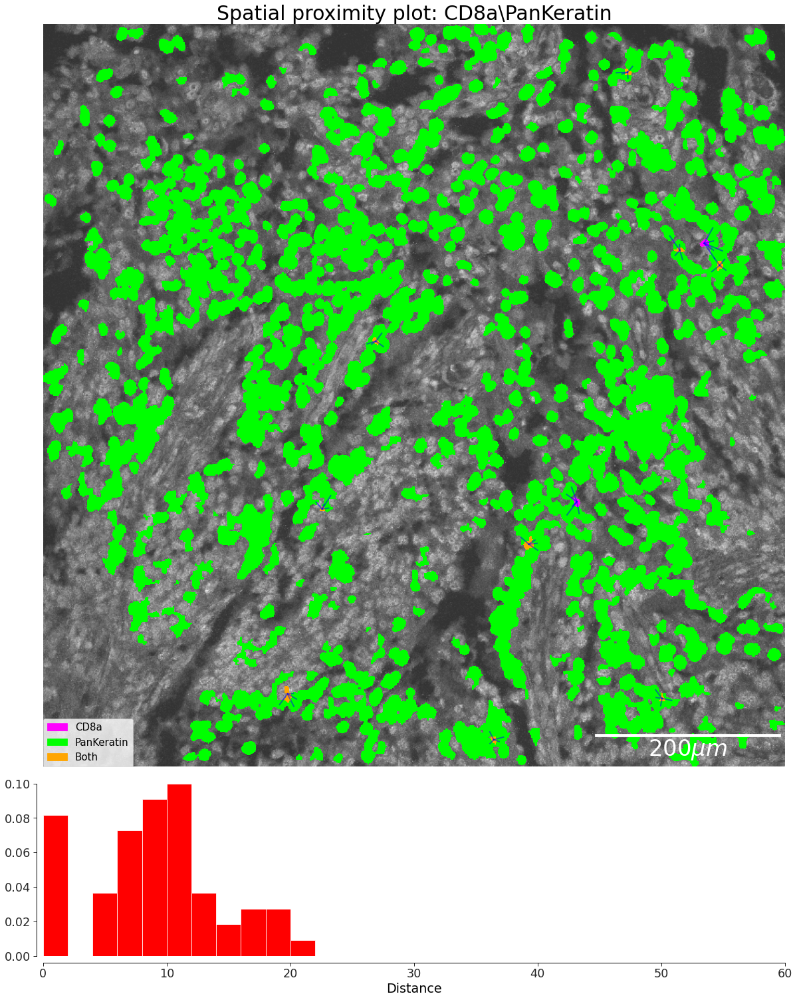

C:\Users\thu71\.conda\envs\spatial_signaling\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


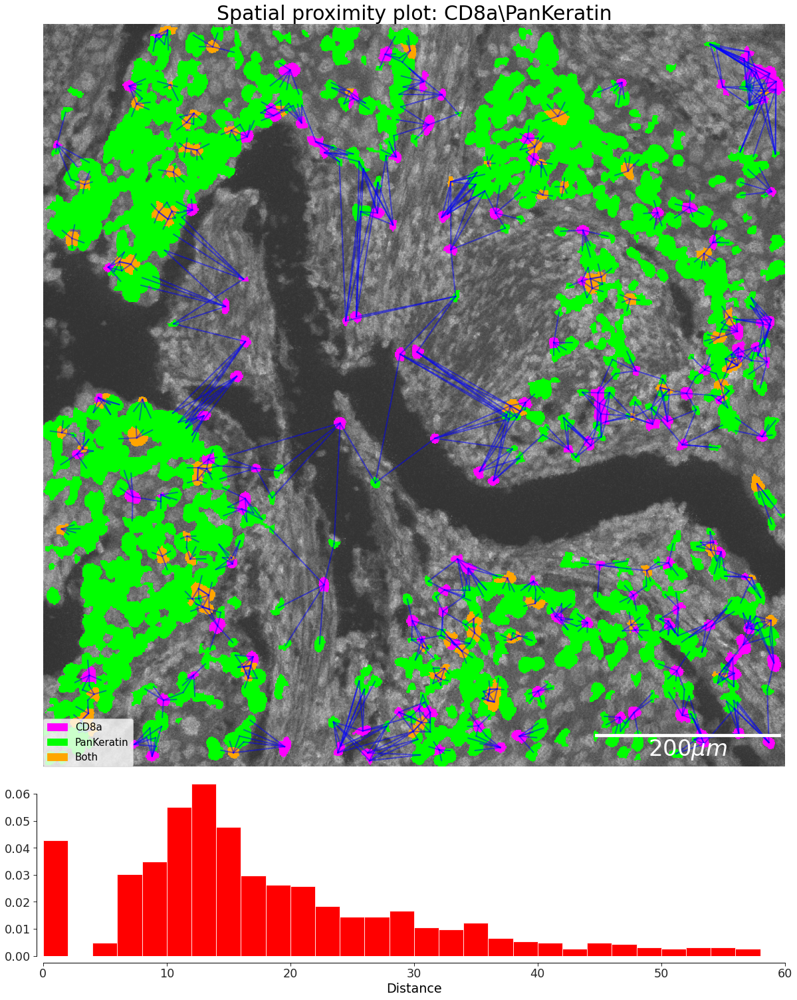

C:\Users\thu71\.conda\envs\spatial_signaling\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


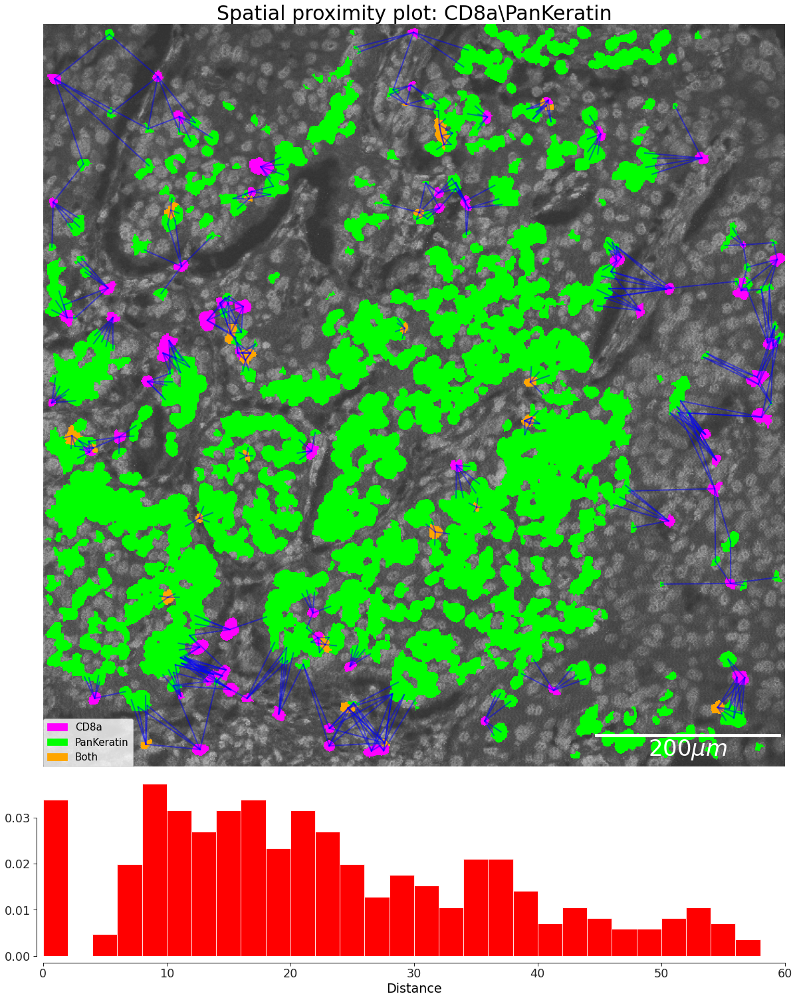

C:\Users\thu71\.conda\envs\spatial_signaling\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


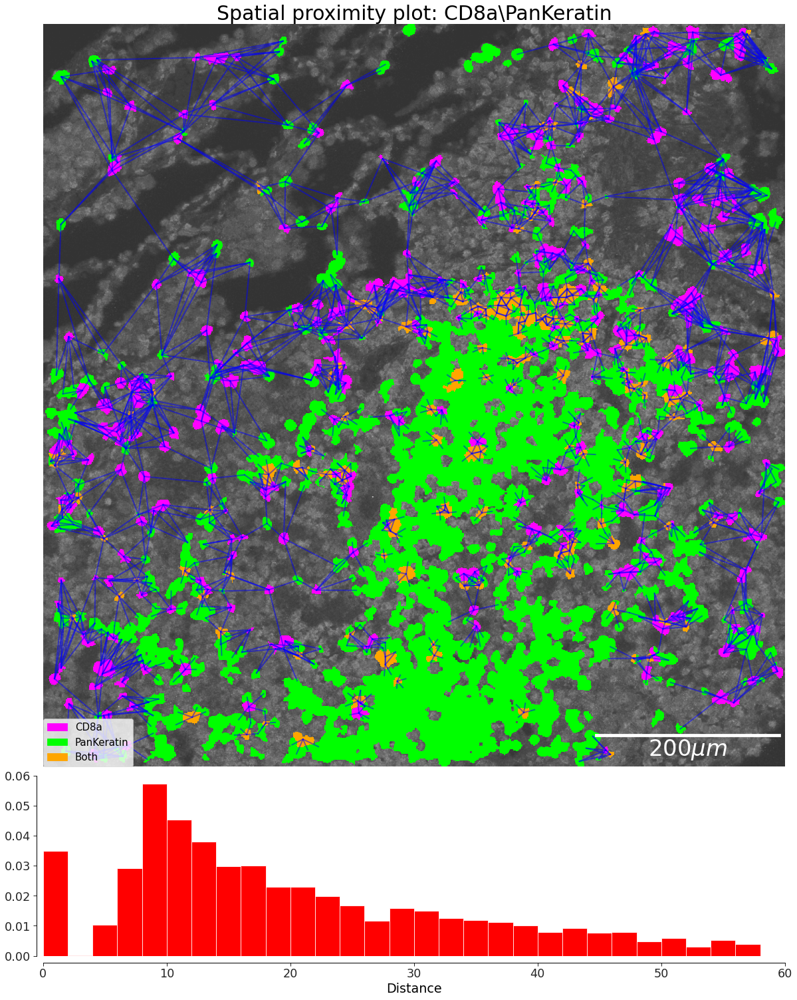

C:\Users\thu71\.conda\envs\spatial_signaling\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


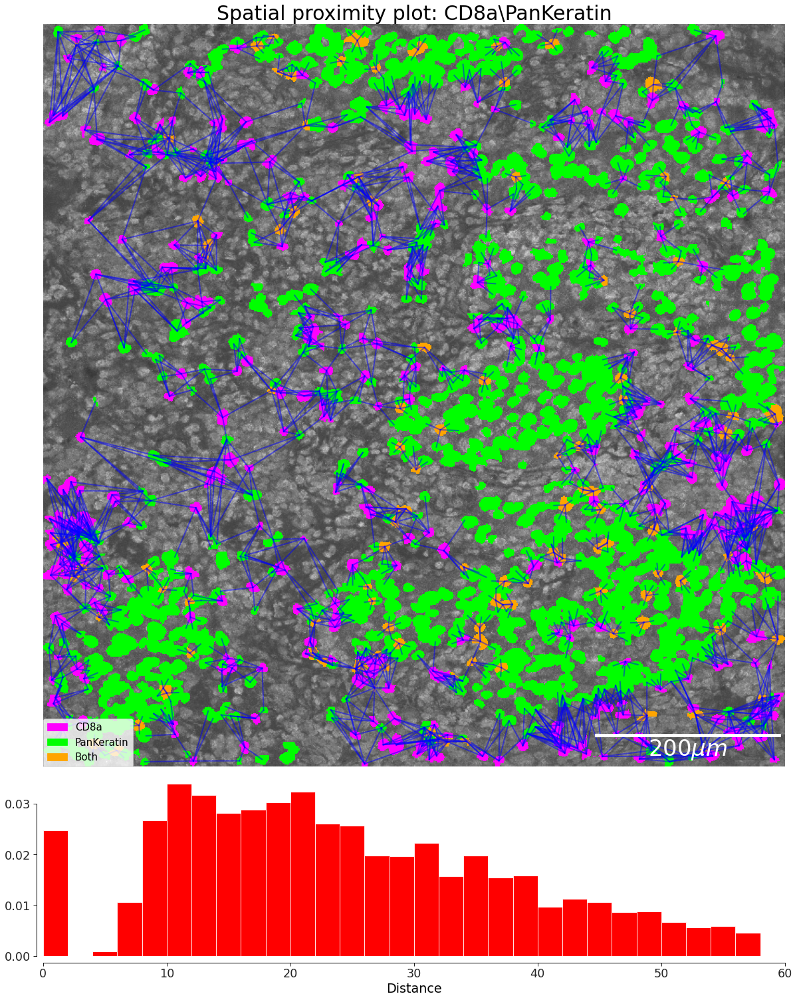

C:\Users\thu71\.conda\envs\spatial_signaling\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


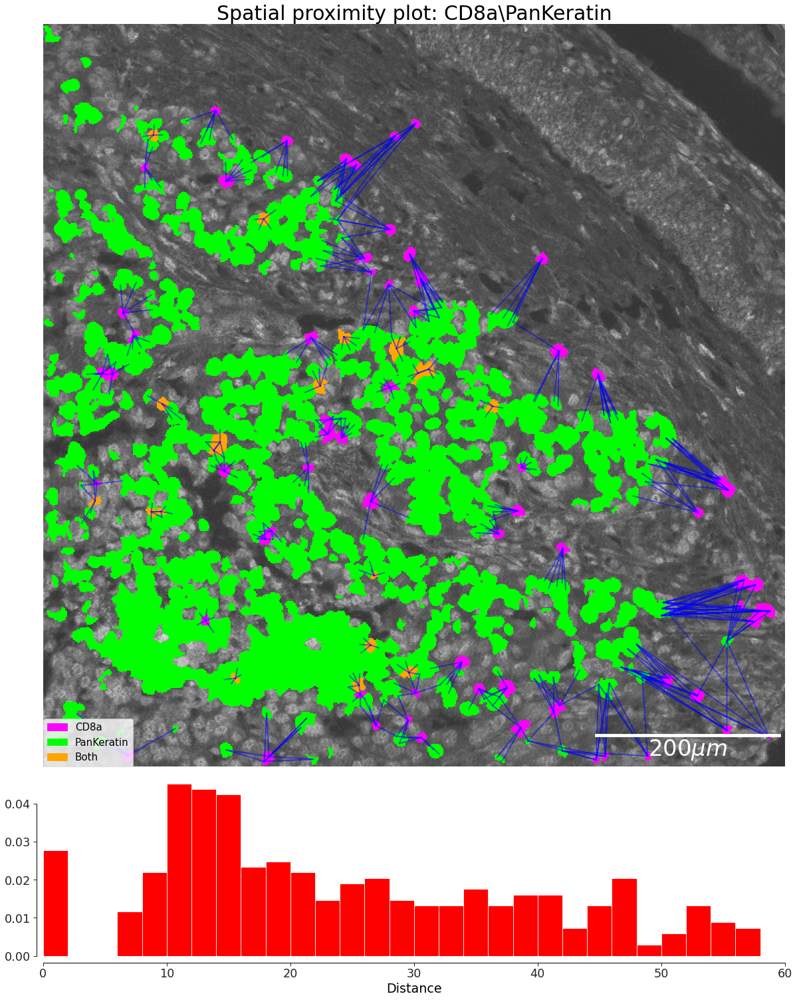

C:\Users\thu71\.conda\envs\spatial_signaling\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


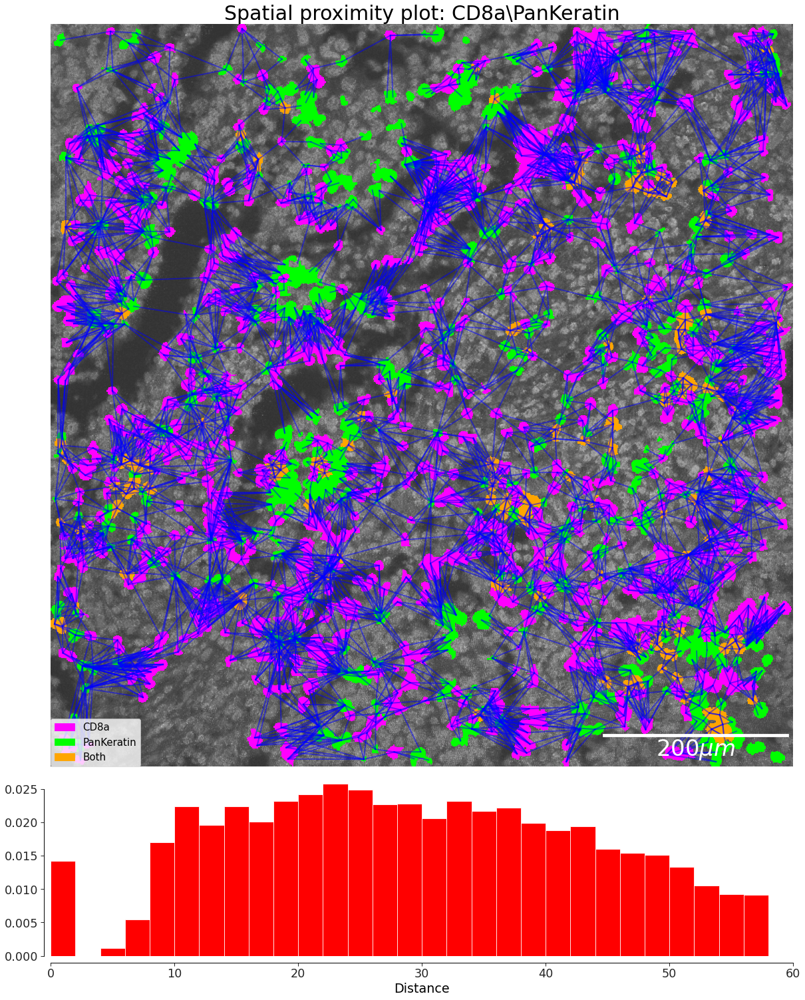

C:\Users\thu71\.conda\envs\spatial_signaling\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


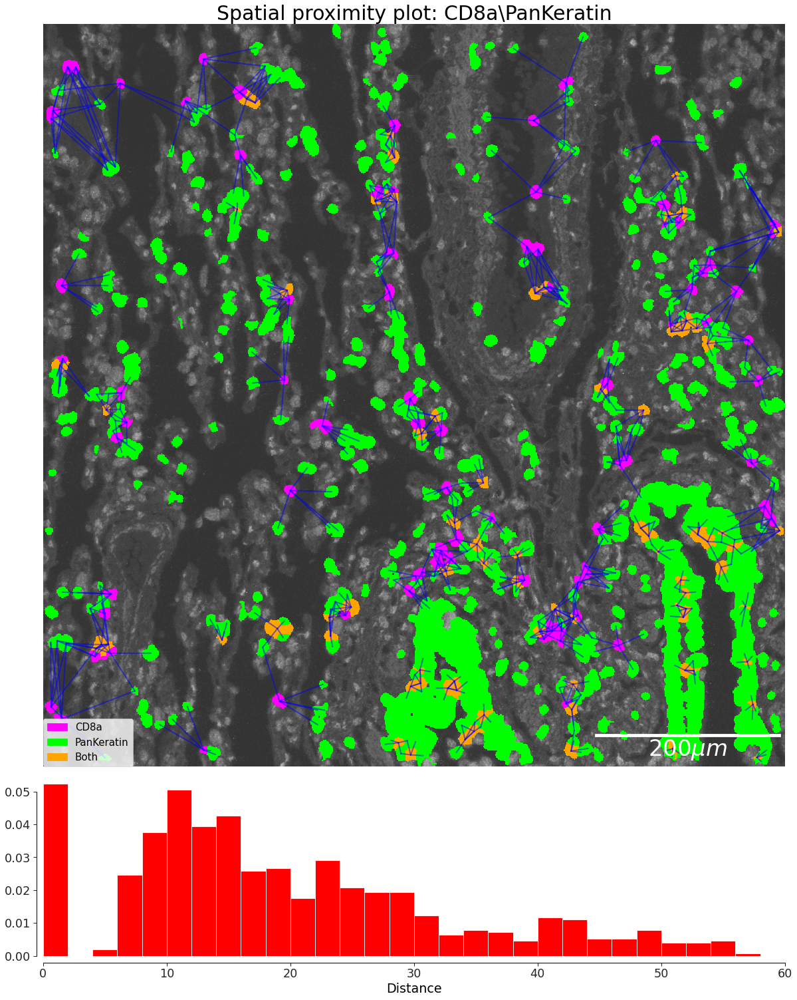

C:\Users\thu71\.conda\envs\spatial_signaling\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


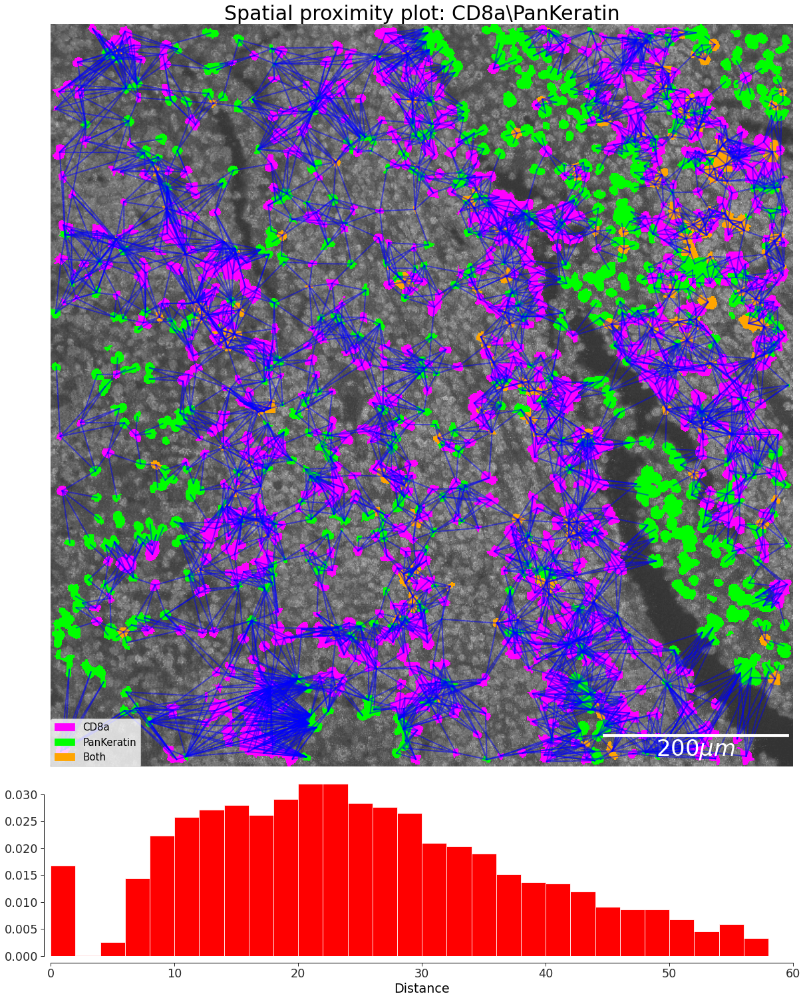

C:\Users\thu71\.conda\envs\spatial_signaling\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


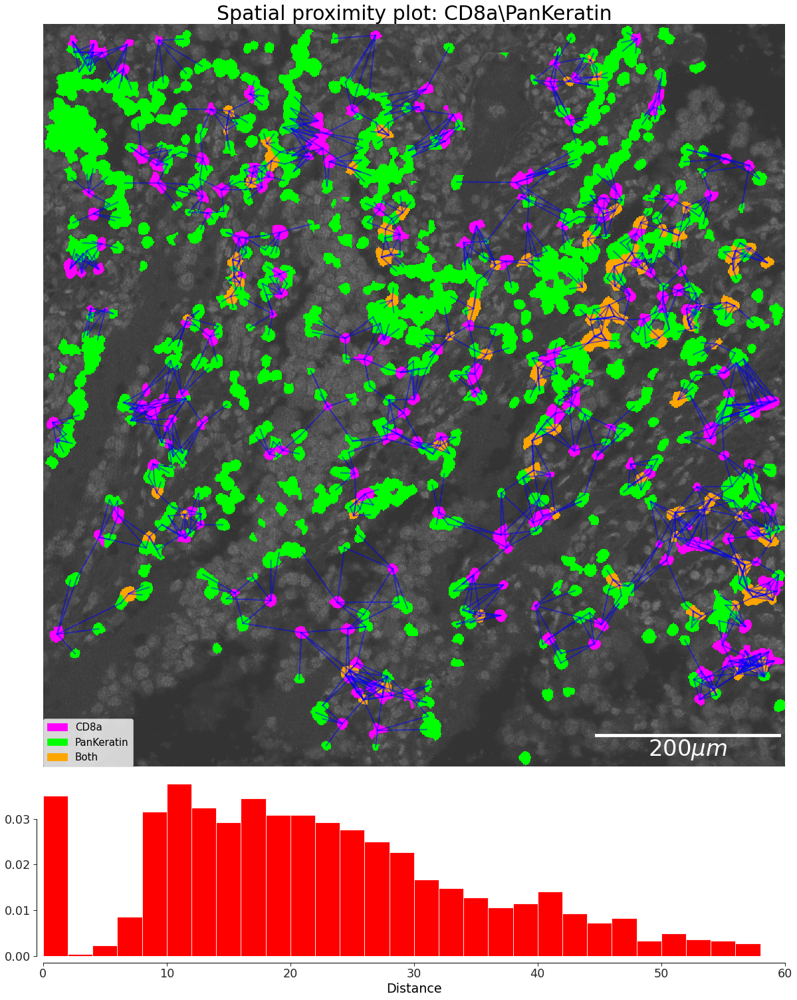

C:\Users\thu71\.conda\envs\spatial_signaling\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


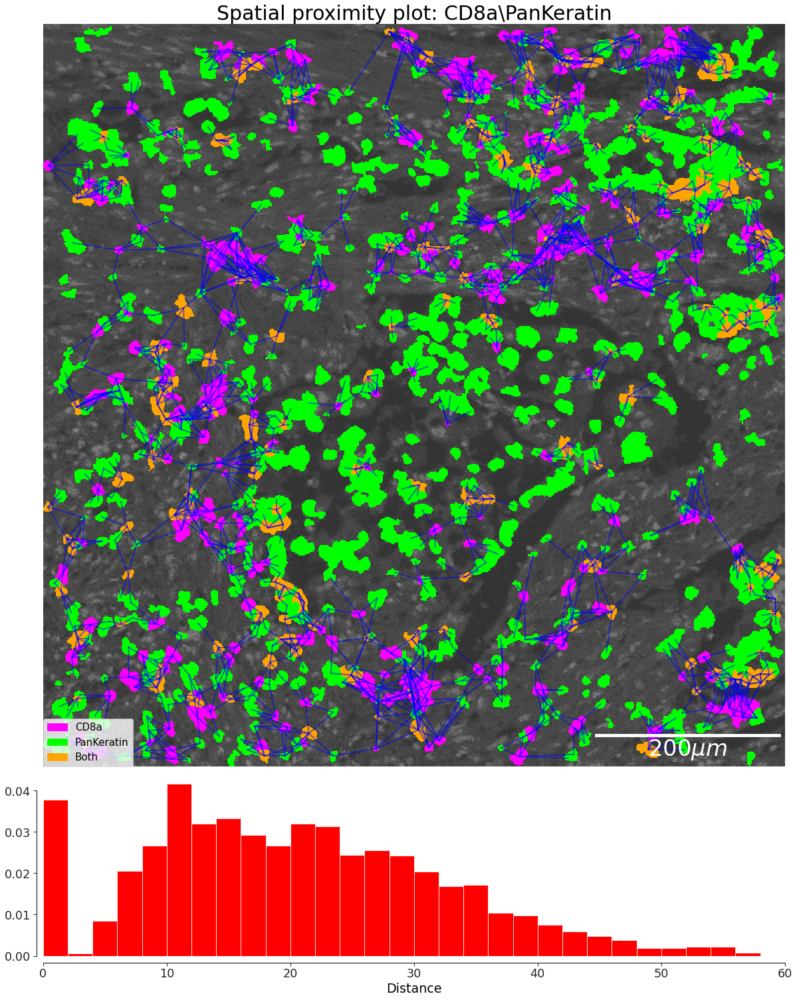

C:\Users\thu71\.conda\envs\spatial_signaling\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


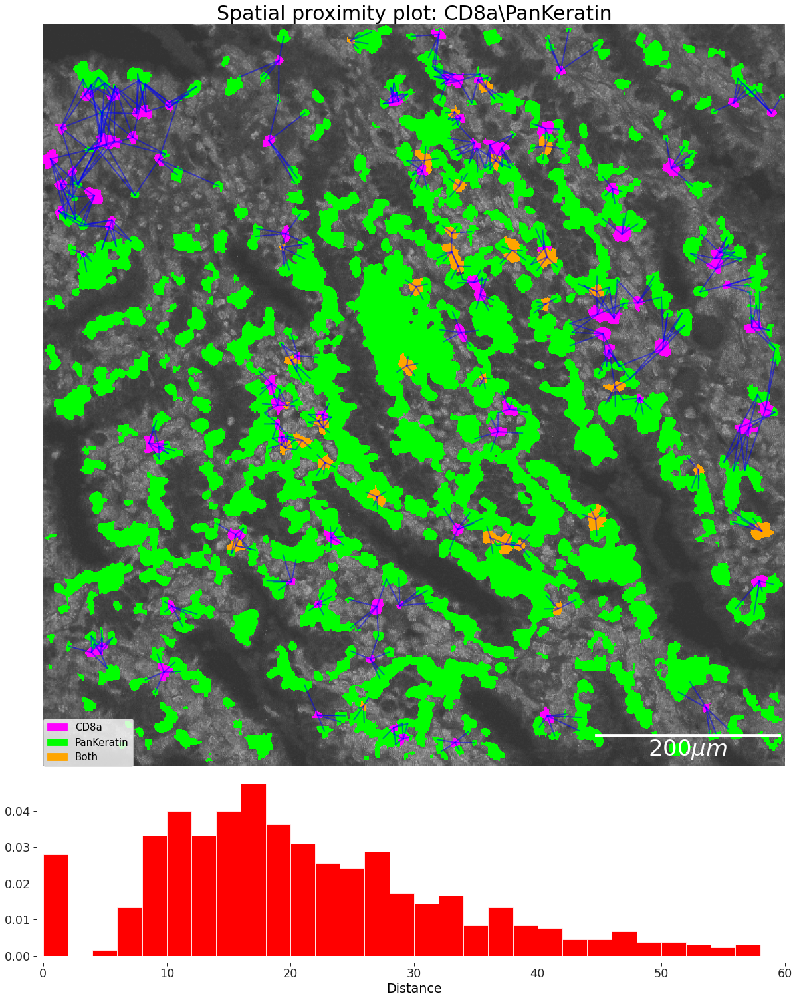

C:\Users\thu71\.conda\envs\spatial_signaling\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


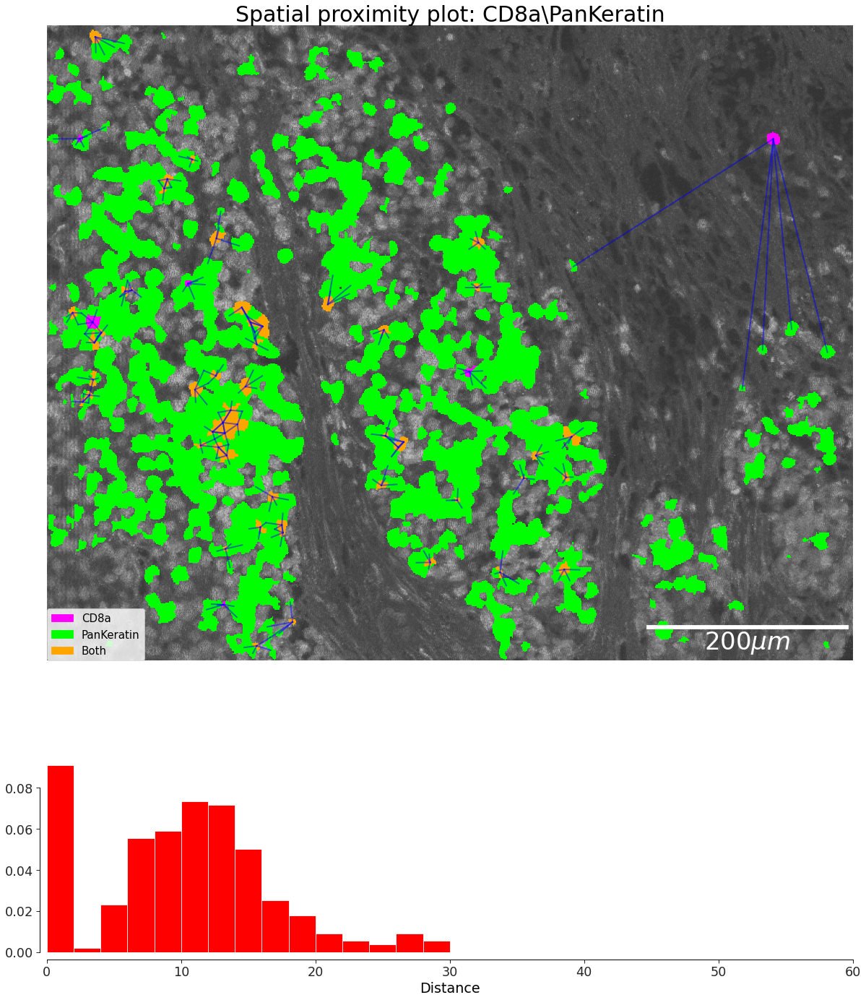

C:\Users\thu71\.conda\envs\spatial_signaling\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


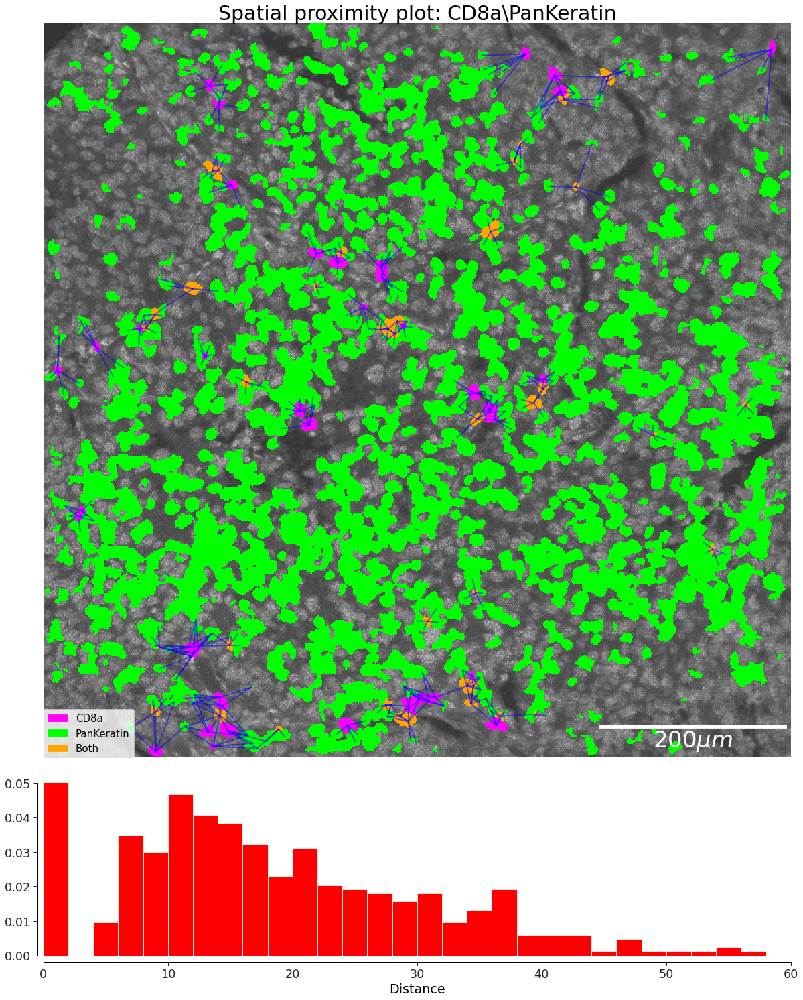

In [22]:
for dataset in datasets: 
    cell_mask = io.read_cell_mask(dataset, data_ROI)
    imgs, markers = io.read_img(dataset, data_ROI)
    marker2img = dict(zip(markers, imgs))
    plot_interaction(marker1, marker2, 
                     marker2img, 
                     imgs, 
                     cell_mask, 
                     path = data_figure / 'pairwise' / f'proximity_{dataset}_{marker1}_{marker2}.png')